In [119]:
import cv2
from matplotlib import pyplot as plt
%matplotlib inline
import numpy as np
import glob
import pandas as pd
from sklearn.cluster import KMeans

from keras.applications import vgg16
from PIL import Image

In [120]:
from utils import *

In [121]:
limit_mem()

In [122]:
def to_plot(img):
    return np.rollaxis(img, 0, 3).astype(np.uint8)
def plot(img):
    plt.imshow((img))

## Pretrained

In [123]:
model=vgg16.VGG16()

### load data

In [124]:
% cd /mnt/vidme/vid1/persons
person_files=glob.glob('*.png')
person_pics=np.random.choice(person_files,len(person_files),replace=False)

/mnt/vidme/vid1/persons


In [140]:
# read images and resize
imgs=[]
for file in person_files:
    img=Image.open(file)
    img=img.resize([224,224])
    img=np.array(img)
    
    imgs.append(img)
person_img_array=np.array(imgs)

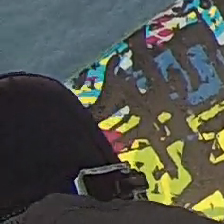

In [142]:
#img.resize(100,100,3)
Image.fromarray(person_img_array[100])

In [9]:
model.summary()

____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
input_1 (InputLayer)             (None, 224, 224, 3)   0                                            
____________________________________________________________________________________________________
block1_conv1 (Convolution2D)     (None, 224, 224, 64)  1792        input_1[0][0]                    
____________________________________________________________________________________________________
block1_conv2 (Convolution2D)     (None, 224, 224, 64)  36928       block1_conv1[0][0]               
____________________________________________________________________________________________________
block1_pool (MaxPooling2D)       (None, 112, 112, 64)  0           block1_conv2[0][0]               
___________________________________________________________________________________________

In [12]:
#get output 1 layer b4 top
intermediate_layer_model = Model(input=model.input,output=model.get_layer('fc2').output)
intermediate_output = intermediate_layer_model.predict(person_img_array)

In [101]:
output = model.predict(person_img_array)

## clustering

In [18]:
cd ~/nbs/vidme/

/home/ubuntu/nbs/vidme


In [20]:
df=pd.read_csv('tags.csv')
df.head(2)

,id,tag
0,689.0,2
1,1714.0,2


In [102]:
kmeans = KMeans(n_clusters=10, random_state=0).fit(output)
labels=kmeans.labels_

In [70]:
from sklearn import metrics
df.tag.values
np.array(labels)[df.id.astype(int).values]
metrics.adjusted_rand_score(df.tag.values+np.random.choice(2,48), df.tag.values)
#metrics.adjusted_rand_score(np.array(labels)[df.id.astype(int).values], df.tag.values)  

0.47350706040127272

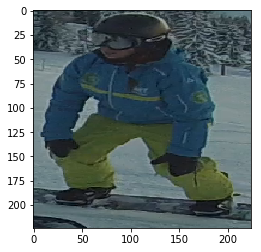

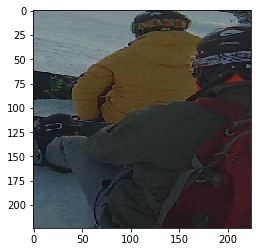

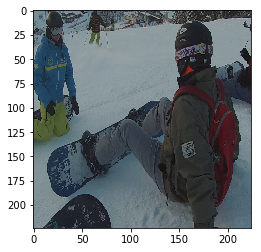

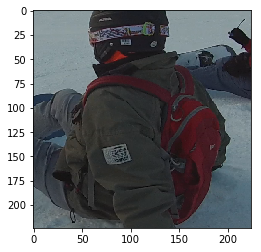

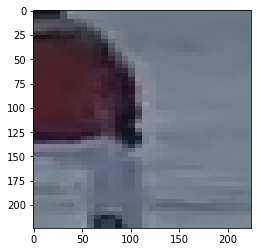

...

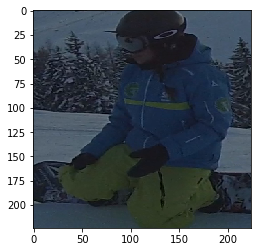

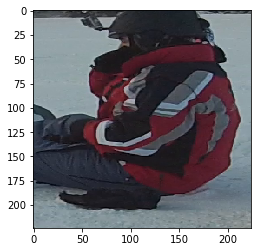

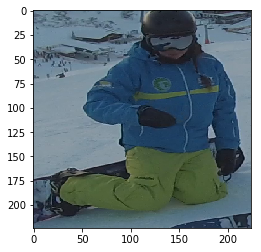

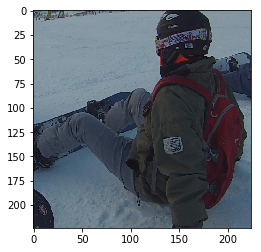

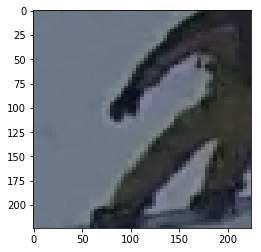

In [104]:
#show similar images
i=1
for i in np.where(labels==1)[0]:
    img = Image.open('/mnt/vidme/vid1/persons/resized'+str(i)+'.png')
    plot(img)
    plt.show()

In [26]:

from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca.fit(intermediate_output)

print(pca.explained_variance_ratio_) 

[ 0.16643357  0.06634423]


In [43]:
pca = PCA(n_components=30, svd_solver='full')
pca.fit(intermediate_output)                 

a=pca.transform(intermediate_output)
print(pca.explained_variance_ratio_) 

[ 0.16643357  0.06634423  0.05568824  0.04477002  0.03415883  0.0287099
  0.0265267   0.02202916  0.01990146  0.0187438   0.01694484  0.01516609
  0.01446391  0.0120145   0.01170481  0.0107612   0.00968782  0.00929234
  0.00910804  0.00825481  0.00795514  0.00781336  0.00735939  0.00719674
  0.00670465  0.00639039  0.00585039  0.00575427  0.00557687  0.00542173]


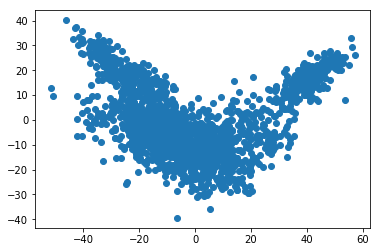

In [80]:
plt.scatter(a[:,0], a[:,1])
plt.show()

## Semi supervised

In [108]:
from IPython.display import display,clear_output
from ipywidgets import widgets

text=widgets.Text()

In [110]:
def handle_submit(sender):
    global id
    df=pd.read_csv('tags.csv')
    clear_output()
    print(text.value)
    #categories[id]=text.value
    if id not in df.id.values:
        df=df.append(pd.DataFrame({'id':[id],'tag':[text.value]}))
        #print (df)
    i=int(text.value)
    id=np.random.choice(1778)
    show_img(id)
    df.to_csv('tags.csv',index=False)
    print (len(df))
    

def show_img(num):
    img=Image.fromarray(np.uint8(person_img_array[num]))
    plot(img)
    plt.show()

In [113]:
df

,id,tag
0,689.0,2
1,1714.0,2
2,1174.0,6
3,1644.0,7
4,1734.0,6
5,289.0,6
6,215.0,1
7,262.0,0
8,1397.0,1
9,177.0,1


In [112]:
people={1:'wendy',2:'gidi',3:'shimshi',4:'elad',5:'white_pants'\
       ,6:'green_suite',7:'random',0:'false'}

7


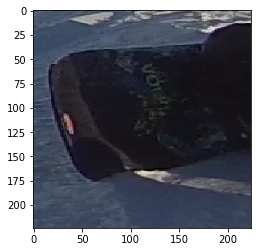

51


In [111]:
#interactive tagging

display(text)
num=0

text.on_submit(handle_submit)
num=np.random.choice(1778)
show_img(num)

In [75]:
#take what I have currenlty tagged, and fine tune the vgg
for layer in model.layers: layer.trainable=False

In [78]:
model.layers[-1].trainable=True

In [98]:
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

In [82]:
np.array(person_img_array)[df.id.astype(int).values].shape, df.tag.values

((48, 224, 224, 3),
 array([2, 2, 6, 7, 6, 6, 1, 0, 1, 1, 2, 2, 4, 4, 6, 6, 1, 1, 2, 2, 2, 2, 0,
        0, 7, 7, 4, 4, 6, 6, 3, 3, 2, 2, 6, 6, 1, 1, 0, 0, 4, 4, 6, 6, 7, 7,
        2, 2]))

In [95]:
tag_vals=to_categorical(df.tag.values)

In [93]:
def to_categorical(y, nb_classes=None):
    """Converts a class vector (integers) to binary class matrix.
    E.g. for use with categorical_crossentropy.
    # Arguments
        y: class vector to be converted into a matrix
            (integers from 0 to nb_classes).
        nb_classes: total number of classes.
    # Returns
        A binary matrix representation of the input.
    """
    y = np.array(y, dtype='int').ravel()
    if not nb_classes:
        nb_classes = np.max(y) + 1
    n = y.shape[0]
    categorical = np.zeros((n, nb_classes))
    categorical[np.arange(n), y] = 1
    return categorical

In [96]:
from keras.applications.inception_v3 import InceptionV3
from keras.preprocessing import image
from keras.models import Model
from keras.layers import Dense, GlobalAveragePooling2D
from keras import backend as K

# create the base pre-trained model
base_model = InceptionV3(weights='imagenet', include_top=False)

# add a global spatial average pooling layer
x = base_model.output
x = GlobalAveragePooling2D()(x)
# let's add a fully-connected layer
x = Dense(1024, activation='relu')(x)
# and a logistic layer -- let's say we have 200 classes
predictions = Dense(8, activation='softmax')(x)

# this is the model we will train
model = Model(input=base_model.input, output=predictions)

# first: train only the top layers (which were randomly initialized)
# i.e. freeze all convolutional InceptionV3 layers
for layer in base_model.layers:
    layer.trainable = False

In [100]:
model.fit(np.array(person_img_array)[df.id.astype(int).values],tag_vals)

Epoch 1/10
48/48 [==============================] - 2s - loss: 2.2478 - acc: 0.1250     
Epoch 2/10
48/48 [==============================] - 0s - loss: 0.2243 - acc: 0.9792     
Epoch 3/10
48/48 [==============================] - 0s - loss: 0.0493 - acc: 1.0000     
Epoch 4/10
48/48 [==============================] - 0s - loss: 0.0049 - acc: 1.0000     
Epoch 5/10
48/48 [==============================] - 0s - loss: 0.0072 - acc: 1.0000     
Epoch 6/10
48/48 [==============================] - 0s - loss: 0.0023 - acc: 1.0000         

## tsne

In [114]:
!wget http://deeplearning.net/data/mnist/mnist.pkl.gz

--2017-03-12 15:42:37--  http://deeplearning.net/data/mnist/mnist.pkl.gz
Resolving deeplearning.net (deeplearning.net)... 132.204.26.28
Connecting to deeplearning.net (deeplearning.net)|132.204.26.28|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 16168813 (15M) [application/x-gzip]
Saving to: 'mnist.pkl.gz'

mnist.pkl.gz        100%[===================>]  15.42M  50.6MB/s    in 0.3s    

2017-03-12 15:42:38 (50.6 MB/s) - 'mnist.pkl.gz' saved [16168813/16168813]



In [118]:
cd .

/home/ubuntu/nbs/vidme
The history saving thread hit an unexpected error (OperationalError('database is locked',)).History will not be written to the database.


## dominant color